# Steganography Through Image Processing
presented by:<br>
**Cabral, Jose Paulo C.&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Lopez, Joshua Albert T.&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Lucana, Reinhold E.&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;Matienzo, John Edward Sam T.**

---

**Steganography**, derived from the Greek words *steganos* (meaning hidden or covered) and *graph* (meaning to write), is the technique of concealing secret data within a non-secret file or transmission to prevent discovery; the secret data is then retrieved at its destination. Steganography can be used in conjunction with encryption to conceal or safeguard data ([Semilof]("https://searchsecurity.techtarget.com/definition/steganography"), 2021).
<br>

With the use of image processing, steganography can be applied to images to produce a ***stego image***; the output of the embedding process which contain the hidden message either in pixel values or in optimally selected coefficients. This done by reducing the image in their numerical forms, which essentially are pixel values. These pixel values, can then be mathematically manipulated in order to produce an image that looks normal to the naked eye, but has been manipulated to contain a secret.
<br>

This notebook demonstrates how steganography can be performed to hide *(a) text inside an image* and *(b) image inside another image* using the concepts of value replacements and extraction of the *most significant bits (MSB)* and the *least signigicant bits (LSB)* of an image.

## Hiding Text Inside an Image

Installing the necessary libraries.

In [1]:
%pip install opencv-python
%pip install numpy
%pip install cryptography
%pip install paramiko
%pip install matplotlib
%pip install requests
%pip install scipy
%pip install scikit-image

Importing the installed libraries.

In [2]:
from cv2 import imread,imwrite
import numpy as np
from base64 import urlsafe_b64encode
from hashlib import md5
from cryptography.fernet import Fernet
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageChops, ImageDraw
import requests
from io import BytesIO
from skimage import io

Function to convert a text (in `string` format) into a binary representation (in `string` format as well).

In [3]:
def str2bin(string):
    return ''.join((bin(ord(i))[2:]).zfill(7) for i in string)

Function to convert a binary representation (from a `string` format) into text (in `string` format).

In [4]:
def bin2str(binary):
    return ''.join(chr(int(binary[i:i+7],2)) for i in range(len(binary))[::7])

A dedicated function for text encryption.

In [5]:
def encrypt_decrypt(string,password,mode='enc'):
    _hash = md5(password.encode()).hexdigest() # Create a hash of the password provided using MD5.
    cipher_key = urlsafe_b64encode(_hash.encode()) # Encode the password hash bytes to Base64 as the cipher key.
    cipher = Fernet(cipher_key)  # Create a symmmetric encryption object, encrypted with the calculated Base64 cipher key.

    if mode == 'enc': # Check the invocation of the function.
        return cipher.encrypt(string.encode()).decode() # If the function is intended to encrypt, execute the encryption method of the symmetric encryption object.
    else:
        return cipher.decrypt(string.encode()).decode() # Otherwise, the function is intended to decrypt. Thus, execute the decryption method of the symmetric encryption object.

Function to embed a secret text inside an image by storing the bits of the message in the LSB of the image.

In [6]:
def encode(input_filepath,text,output_filepath,password=None,progressBar=None):
    if password != None: # Check if a password is provided.
        data = encrypt_decrypt(text,password,'enc') # If a password is provided, encrypt the data with given password.
    else:
        data = text # Otherwise, allow the data to remain in its raw form.

    data_length = bin(len(data))[2:].zfill(32) # Intialize the placeholder of the data by converting the length of the provided data to a binary string, and add leading zeros to ensure that the length is 32 characters.
    bin_data = iter(data_length + str2bin(data)) # Create an iterative object from the appended string value of the data placeholder and the message converted into its binary representation.
    img = imread(input_filepath,1) # Read the input image.

    if img is None: # Check if an image is loaded from the input image path supplied.
       print("Error: The image file '{}' is inaccessible".format(input_filepath)) # Show an error message if the input image path is invalid.

    height,width = img.shape[0],img.shape[1] # Take note of the height and width of the image.
    encoding_capacity = height*width*3 # Calculate the encoding capacity of the input RGB image by multiplying its number of pixels vertically (height), number of pixels horizontally (width), and number of channels (red, green, and blue counts as 3).
    total_bits = 32+len(data)*7 # The total bits for the message is calculated as 32, added with the length of the message, multipled by 7. This is the same as counting the characters inside the iterative object.

    if total_bits > encoding_capacity: # Check if the binary representation of the message will fit to the supplied input image by comparing the total bits it require with the image's encoding capacity.
        print("Error: The data size is too big to fit in this image!") # Show an error if the size of the message will not fit in the image.

    completed = False # Initialize completion to False boolean.
    modified_bits = 0 # Initialize the number of modified bits counter to 0.
        
    for i in range(height): # Iterate through the image's height.
        for j in range(width): # Iterate through the image's width.
            pixel = img[i,j] # Access the pixel at the iterated height and width.
            for k in range(3): # Iterate through the pixel's RGB channel.
                try: # Try getting the next value in the iterative object.
                    x = next(bin_data)
                except StopIteration: # If no value can be accessed anymore, break the loop and set the completed boolean to True.
                    completed = True
                    break
                if x == '0' and pixel[k]%2==1: # Check if the bit to be encoded is 0 and if the current LSB is 1.
                    pixel[k] -= 1 # Change the LSB from 1 to 0.
                    modified_bits += 1 # Increase the counter for the number of modified bits.
                elif x=='1' and pixel[k]%2==0: # Check if the bit to be encoded is 1 and if the current LSB is 0.
                    pixel[k] += 1 # Change the LSB from 0 to 1.
                    modified_bits += 1 # Increase the counter for the number of modified bits.
            if completed: # If all of the bits to be encoded are encoded already, stop the iteration.
                break
        if completed: # If all of the bits to be encoded are encoded already, stop the iteration.
            break

    written = imwrite(output_filepath,img) # Store the modified image in the provided output file path.

    if not written: # Check if no image is written.
        print("Error: Failed to write image '{}'".format(output_filepath)) # Show an error message if the image fails to write in the desired output file path.

    loss_percentage = (modified_bits/encoding_capacity)*100 # Calculate the loss in quality by dividing the number of modified bits with the image encoding capacity and multiplying it to 100%.

    return loss_percentage # Set the loss percentage as the return value.

Function to extract a secret data inside an image by extracting the LSB of the image and reconstructing it to recreate the message.

In [7]:
def decode(input_filepath,password=None):
    result,extracted_bits,completed,number_of_bits = '',0,False,None # Initialize the variables for the result, the number of extracted bits, the completion boolean, and the number of bits or the data size.
    img = imread(input_filepath) # Read the image from the provided file path.

    if img is None: # Check if an image is loaded from the input image path supplied..
        print("Error: The image file '{}' is inaccessible".format(input_filepath))  # Show an error message if the input image path is invalid.

    height,width = img.shape[0],img.shape[1] # Take note of the height and width of the image.

    for i in range(height): # Iterate through the image's height.
        for j in range(width): # Iterate through the image's width.
            for k in img[i,j]: # Access the pixel at the iterated height and width and iterate through its RGB values.
                result += str(k%2) # Extract the LSB of the value and append to the result variable.
                extracted_bits += 1 # Increase the counter for the number of extracted bits.
                if extracted_bits == 32 and number_of_bits == None: # Check if the first 32 bits are extracted.
                    number_of_bits = int(result,2)*7 # If it is, set the data size to the number of bits to be extracted in the image.
                    result = '' # Reinitialize the result variable.
                    extracted_bits = 0 # Reset the number of extracted bits counter back to 0.
                elif extracted_bits == number_of_bits: # Check if the number of extracted bits and the data size or number of bits to be extracted matches count.
                    completed = True # Set the completion boolean and stop the iteration.
                    break
            if completed: # If all of the bits to be extracted are extracted already, stop the iteration.
                break
        if completed: # If all of the bits to be extracted are extracted already, stop the iteration.
            break
    
    if password == None: # Check if no password is provided.
        return bin2str(result) # If no password is provided, the result is immediately converted into a string and returned to the user.
    else: # If a password is provided.
        try: # Try decrypting the converted string value of the binary data.
            return encrypt_decrypt(bin2str(result),password,'dec')
        except: # If the password that was provided was incorrect, display a message showing the the password provided was invalid.
            print("Error: Invalid password!")

### Demonstration

A cover image was set.

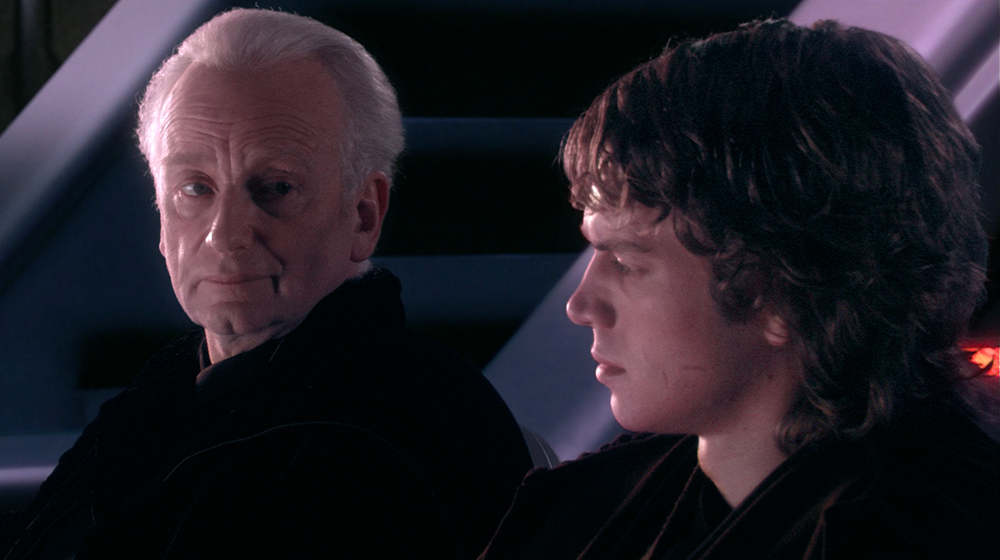

In [8]:
url = 'https://static.wikia.nocookie.net/starwars/images/c/c3/Tragedy.jpg/'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('original-image.png')
img

The secret message, the password (if needed) and the intended output path for the steg image were set. The encoding function was executed afterwards.

In [9]:
INPUT_FILEPATH = 'original-image.png'
OUTPUT_FILEPATH = 'secret-image.png'
MESSAGE = """
Did you ever hear the tragedy of Darth Plagueis The Wise? I thought not.
It’s not a story the Jedi would tell you. It’s a Sith legend. Darth Plagueis
was a Dark Lord of the Sith, so powerful and so wise he could use the Force to
influence the midichlorians to create life… He had such a knowledge of the dark
side that he could even keep the ones he cared about from dying. The dark side
of the Force is a pathway to many abilities some consider to be unnatural. He
became so powerful… the only thing he was afraid of was losing his power, which
eventually, of course, he did. Unfortunately, he taught his apprentice
everything he knew, then his apprentice killed him in his sleep. Ironic. He
could save others from death, but not himself.
"""
PASSWORD = 'pa$$w0rD'

encode(input_filepath=INPUT_FILEPATH,text=MESSAGE,output_filepath=OUTPUT_FILEPATH,password=PASSWORD)

0.10832457983193278

The resulting steg image was previewed.

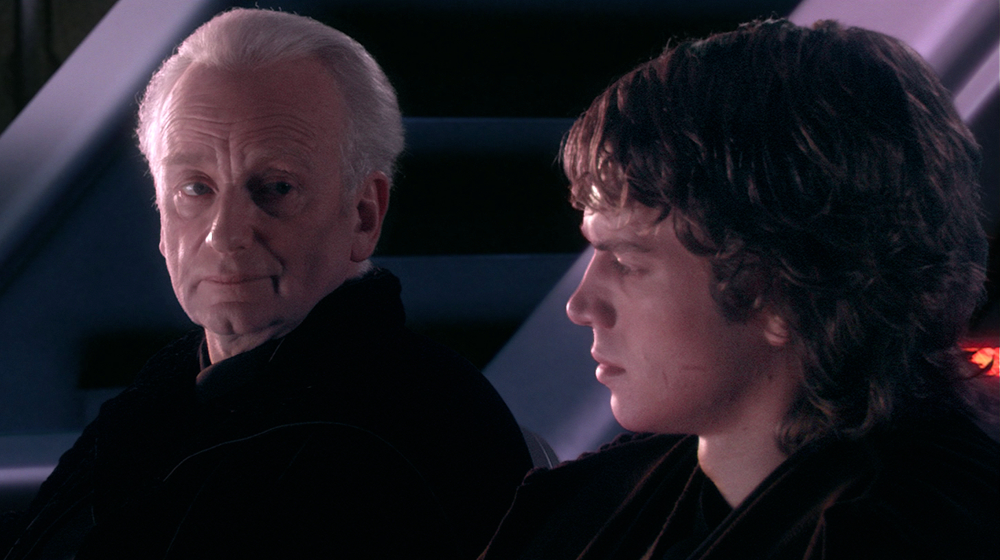

In [10]:
SECRET_IMAGE = 'secret-image.png'

img = Image.open(SECRET_IMAGE)
img

A side-by-side comparison of the original cover image and the produced stego image using histograms, where in the respective RGB values (from 0-255) for each image are mapped.

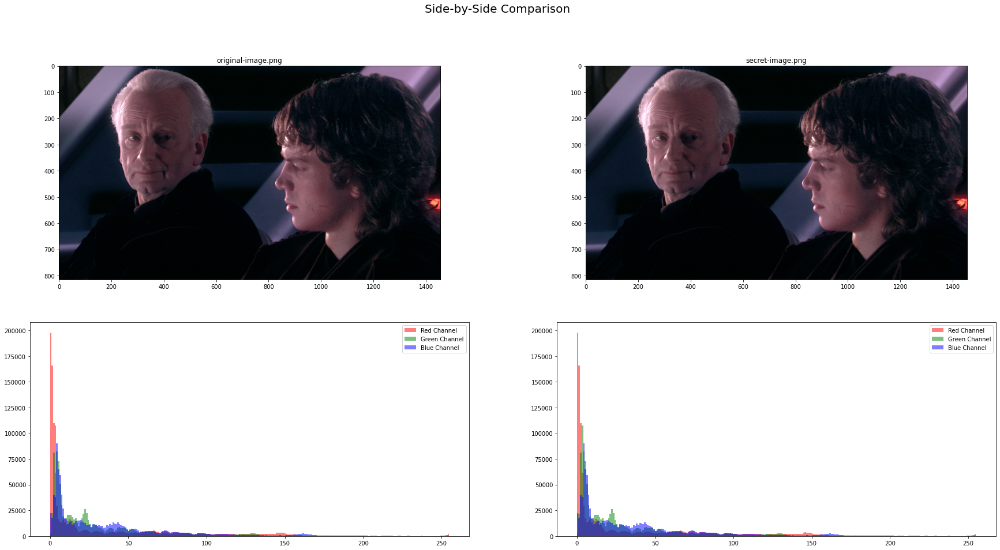

In [11]:
ORIGINAL_IMAGE = 'original-image.png'
SECRET_IMAGE = 'secret-image.png'

img1 = io.imread(ORIGINAL_IMAGE) 
img1_array = np.array(img1, dtype=np.uint8)

img2 = io.imread(SECRET_IMAGE)
img2_array = np.array(img2, dtype=np.uint8)

NUM_ROWS = 2
IMGs_IN_ROW = 2
f, ax = plt.subplots(NUM_ROWS, IMGs_IN_ROW, figsize=(30,15))
f.suptitle('Side-by-Side Comparison', fontsize=20)

ax[0,0].imshow(img1)
ax[0,0].set_title(ORIGINAL_IMAGE)
ax[1,0].hist(img1[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,0].hist(img1[:, :, 1].ravel(), bins = 256, color = 'green', alpha = 0.5)
ax[1,0].hist(img1[:, :, 2].ravel(), bins = 256, color = 'blue', alpha = 0.5)
ax[1,0].legend(['Red Channel', 'Green Channel', 'Blue Channel'])


ax[0,1].imshow(img2)
ax[0,1].set_title(SECRET_IMAGE)
ax[1,1].hist(img2[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,1].hist(img2[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
ax[1,1].hist(img2[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
ax[1,1].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

plt.show()

Decoding the secret message hidden inside the stego image.

In [12]:
INPUT_FILEPATH = 'secret-image.png'
PASSWORD = 'pa$$w0rD'

message = decode(input_filepath=INPUT_FILEPATH,password=PASSWORD)
print(message)


Did you ever hear the tragedy of Darth Plagueis The Wise? I thought not.
It’s not a story the Jedi would tell you. It’s a Sith legend. Darth Plagueis
was a Dark Lord of the Sith, so powerful and so wise he could use the Force to
influence the midichlorians to create life… He had such a knowledge of the dark
side that he could even keep the ones he cared about from dying. The dark side
of the Force is a pathway to many abilities some consider to be unnatural. He
became so powerful… the only thing he was afraid of was losing his power, which
eventually, of course, he did. Unfortunately, he taught his apprentice
everything he knew, then his apprentice killed him in his sleep. Ironic. He
could save others from death, but not himself.



### Test Case for Actual Application

An example of [press conference transcript](https://mirror.officialgazette.gov.ph/1986/02/22/extract-of-the-transcript-of-press-conference-defense-minister-juan-ponce-enrile-and-deputy-chief-of-staff-fidel-v-ramos-on-various-matters/) embedded in an image of a Philippine map.

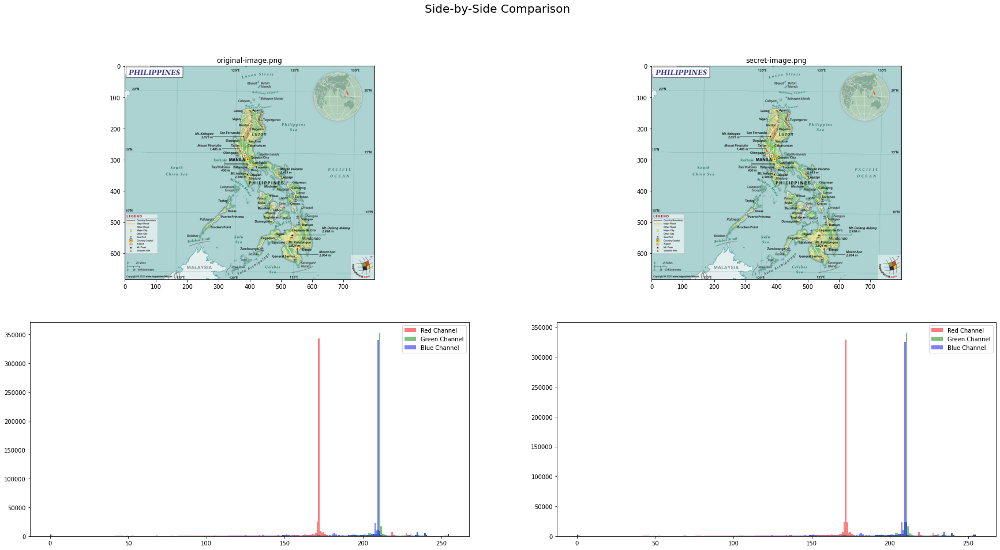

In [13]:
url = 'https://images.mapsofworld.com/answers/2019/06/philippines-map.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('original-image.png')

INPUT_FILEPATH = 'original-image.png'
OUTPUT_FILEPATH = 'secret-image.png'
MESSAGE = """
Extract of the Transcript of Press Conference: Defense Minister Juan Ponce Enrile and Deputy Chief of Staff Fidel V. Ramos on various matters
February 22, 1986

Extract of the Transcript of Press Conference by Defense Minister Juan Ponce Enrile and Deputy Chief of Staff Fidel V. Ramos:
On the resignation of Defense Minister Enrile and Deputy Chief of Staff Ramos, the order to arrest members of Lt. Col. Honasan’s Reform the Armed Forces Movement, the divide in the Armed Forces, and the possibility of a renewed proclamation of Martial Law

[Released from Camp Aguinaldo, Quezon City, February 22, 1986]

Q: Good evening, sir.

DEFENSE MINISTER JUAN PONCE ENRILE: How are you?

Q: Good evening, sir.

ENRILE: This evening, I do not know whether this will be a good evening, but anyway—gentlemen, we are ready to answer your questions.

Q: Sir, is it true that the President has ordered your arrest?

ENRILE: Well, I would prefer this by saying that there was an information to round up members of the Reform Movement. And this afternoon, my boys came to my house and caused me to get out and come to this place because we might all be rounded up. I said information reached us that there was a supposed-to-be an effort to arrest all the members of the Reform Movement and this afternoon, some of my boys came to my house and asked me to move to Camp Aguinaldo because we have to group there because there is a possibility that we will all be rounded up.

Q: Were you worried that your life is in dangers, sir?

ENRILE: I must preface your question that as far back as 1982, we have been getting persistent reports that there were efforts to eliminate us and the information was that they brought in some elements from Mindanao to undertake the job. And, it was at that point that we decided a group to protect ourselves. And, this is actually what is now known as the AFP Reform Movement.

Q: How much of the military do you represent? How long do you intend to be here and what your demands will be?

ENRILE: Well, I do not know how long we will be here. It all depends upon the situation. I hope that the situation will come out better. If not, then, we will make a stand here. And, if we have to go down, all of us will have to go down.

Q: Sir, are you fearful for your life?

ENRILE: Well, we are in a camp and we have some people out there who might assault us.

Q: A lot of troops are around the perimeter of the camp. Does that mean you’re controlling the General Headquarters of the army of the Philippines?

ENRILE: Well, we are in the Ministry of National Defense. As of now, I’m still the Minister of National Defense, and that is why I came here because we have no intention to harm anybody, but the fact is that there was a report that we are going to be arrested—all of us. And, if we are going to be arrested, we know what that means.

Q: Who is us, Sir?

ENRILE: The members of the Reform Movement.

Q: Would that include General Ramos and you?

ENRILE: I think General Ramos.

DEPUTY CHIEF OF STAFF FIDEL V. RAMOS : I am with Minister Enrile. And, the reason for my being here, ladies and gentlemen, is that because the Armed Forces of the Philippines has ceased to be the real Armed Forces of the Philippines which is supposed to be the defender of public safety and enforcer of the law and what has developed is that there has become an elite armed forces within the Armed Forces of the Philippines that no longer represents the rank and file and the officer corps of the Armed Forces of the Philippines.

Q: Minister, what will your demands be?

ENRILE: Well, we want that the will of the people must be respected.

Q: [Inaudible]

ENRILE: Well, for myself, if I may say this, I believe that the mandate of the people does not belong to the present regime. And I know it is for a fact, that there had been some anomalies committed during the elections; and I search my conscience; and I felt that I could not serve a government that is not expressive of the sovereign will.

Q: Did you have any contact with Mrs. Aquino?

ENRILE: We have not had any contact with Mrs. Aquino.

Q: Mr. Minister, what are your demands going to be? Will you stay here until Mr. Ver steps out? Will you stay here until Mr. Marcos steps out?

ENRILE: [To General Ramos] Are you resigning? Did you resign? I was going to tender my resignation on Monday.

Q: Irrevocable?

ENRILE: Yes, I can no longer serve the government.

Q: How about you, General Ramos? Did you tender an irrevocable resignation?

RAMOS: I have tendered my offer of retirement on many occasions. But, at the moment as the chief of the Constabulary and Integrated National Police as well as the Vice-Chief of Staff of the Armed Forces of the Philippines, I would like to direct the troops under my command as well as all other elements of the Armed Forces of the Philippines that are professional-minded, that are dedicated to the military service—in the sense of the military service being the protector of the people—the defender of public safety, and the enforcers of the law in our country, to be with me as well as the Minister of National Defense, in our effort to bring about a more normal situation where our people once more can live freely and pursue the aspirations that they have in life.

Q: Is the Army and Navy and Air Force against you?

ENRILE: Well, not quite. We have some friendly forces in the Navy, Army and Air Force, even the Marines.

Q: [Inaudible]

ENRILE: No, I did not. I did not discuss this with anybody.

Q: Are you saying that you no longer recognize President Marcos as President?

ENRILE: As of now, I cannot in conscience recognize the President as the Commander-in-Chief of the Armed Forces. And, I am appealing to my brother-members of the Cabinet to head the will of the people expressed during the last election. Because in my own region, I know that we cheated the elections to the extent of 350,000 votes.

Q: Are you going to stay and serve under Mrs. Aquino?

ENRILE: No, I will not. I will not serve under Mrs. Aquino even if she is installed as the president. I do not know whether she can be installed as a president. But, I am talking of a country and people, and not men. Our loyalty is to the Constitution, to the Filipino people, to our country. And, I am calling on all decent elements in the government, the decent Filipinos, and the decent soldiers and officers of the Armed Forces of the Philippines who are trained to respect the Constitution, and to protect the welfare of this nation and its people, to wake up and support this movement.

Q: General Ramos, will you recognize Marcos as the Commander-in-Chief of the Armed Forces?

RAMOS: I think the President of 1986 is not the same President that we used to know before to whom we pledged our loyalty and to whom we dedicated our service. But, it is clear that he no longer is the able and capable Commander-in-Chief that we count upon because he has put his personal interest—his family interest.

I would like to appeal likewise as Minister Enrile has done to the fair-minded, to the dedicated, and people-oriented members of the Armed Forces of the Philippines and the Integrated National Police to join us in this crusade for better government. I would like to appeal to our personnel in the thirteen regions of this country, however, to avoid any bloodshed; to maintain calm, and be able to influence the people’s power in our country to support this appeal of Minister Enrile and myself,  because…

ENRILE: You know, we realized the gravity of the situation as far as our lives our concerned, and if it should come to pass that we will lose our lives in this particular moment, we will gladly do it in the service of our people and our nation for that is the oath that we have taken when we entered the public service. It is our duty to see to it that the sovereign will of the Filipino people expressed through the ballot must be respected.

Q: Have you heard of any plans against Cory Aquino or the opposition?

ENRILE: No. What plans are you asking?

Q: The same way they did to you, that they are going to arrest you…

ENRILE: I do not know whether there is any such plan, but I heard that there was a meeting in Malacañang sometime two weeks ago. I think there where some members of the—some generals were present and there was a plan to arrest all the leaders of the opposition, in fact, even some members of the Parliament. And in fact, I just talked to the RUC Commander from the South and I understand certain, some hit men or hit list, directed against UNIDP leaders have been prepared. And, I do not know why this thing is happening in this country.

Q: Can you tell us, sir, what you know about the cheating during the last election—what you personally know about?

ENRILE: In my region, the President obtained 233,000 margin in Cagayan. In Isabela, he got 164,000 votes. In Kalinga, Apayao, he barely made it. In Quirino—I do not know the results there. He lost in Ifugao and in Batanes. I am bothered by my conscience that we have done this to our people. Because under the Constitution, powers of government are supposed to emanate from the sovereign will of our people, and yet, we do not respect the will of our people. The question that I asked myself before I came before you is: Is it worth living to serve a government that does not really represent the will of the people?

Q: Mr. Minister, are you willing to accept the authority of Mrs. Aquino as president?

ENRILE: I am not making any conclusion, whoever is considered by the Filipino people to be representative of their will must be respected.

Q: Is coup d’etat a part of your options?

ENRILE: We never had any plans to stage a coup d’etat. What we are doing is to defend ourselves against an assault that is quite imminent and apparent.

Q: How can the situation be resolved?

ENRILE: I do not know. It is only the President who can resolve this.

RAMOS: I am willing to dialogue with the President, ladies and gentlemen, to express the feelings of those in the Armed Forces of the Philippines. And in fact, that is my primary and only approach.

ENRILE: They can kill all of us here. We are all gathered in this holding and in this camp, but the blood that they will shed will be the blood of Filipinos who love their country more than any man. And, we are not here to serve a man but to serve a republic and a people.

Q: Sir, how many are you in here?

ENRILE: I cannot tell you our number.

Q: General Ramos, have you ordered your troops to come and get you?

RAMOS: I am only appealing to the troops now to do what is right by the Constitution and to do what is right under our laws. And, I would like once more to address an appeal to the Commander-in-Chief to allow us to peacefully negotiate and talk to him. I have transmitted to the President in many occasions in writing as well as face-to-face conversation the feelings of the smaller as well as my humble perceptions of the worsening situation in our country. But as you will know, he has largely ignored these appeals and he has not acted on the very serious problems that confront the country today insofar as peace and order are concerned.

ENRILE: The Armed Forces of the Philippines is no longer the armed forces of the Filipino people as it should be. There is already an attitude on the part of some people that they own the Armed Forces of the Philippines; they own the country; they own everybody. The say that General Ver was retired on Sunday only to be reinstated again; only to be retired again, and they announced General Ramos to be an Acting Chief of Staff but there is a secret order saying that the Chief of Staff must continue  until such time that they will announce his retirement. We can no longer live under this condition. This is no longer a civilized country if this is the way we are running our affairs.

Q: How does Mrs. Marcos figure in this trouble?

ENRILE: I do not know. I have not talked to her.

Q: Mr. Minister, what can you say about the presence of US military warships here?

ENRILE: I do not know why they are here.

Q: Minister Enrile, in this situation where the two of you are holed up in a building with a certain number of men around you, are you causing a split in the military right now?

ENRILE: I think right now, we have a split in the military.

Q: May we have the names of the commanders of major services who are against you?

ENRILE: I think the commanders of the armed services are all with the President and I suppose they have to serve him. But, we are confident that the decent elements in the ranks, in the lower ranks, will know how to deal with the situation. If they will fire their guns against us, so be it, but we have committed this final act in order to bring to the world and to our Filipino people that the sad situation in the country is now coming to pass. And, the day of reckoning is now approaching.

Q: [Inaudible]

ENRILE: If they will kill us, I think they will find that the situation in the land will no longer be governable.

Q: When you talk with the President, you and General Ramos, will you ask that he step down…

ENRILE: I think we should respect the will of the people. Personally, I believe that the President did not win this election. He was proclaimed by the Batasan in a hasty manner. And, I felt embarrassed when I was sitting there watching the proceedings. I had to raise my hand to show that I voted for him, but inside me, it bothered me that I had raised my hand. And, I am sorry to say this because I had served him well over the years, but I am a Filipino over and above anything else.

Q: Will you call on the people to support you and General Ramos? Will you ask that he step down…

ENRILE: It’s up to them, if they want to support us. We are here to take a stand. If anyone of us will be killed—I think all of us must be killed.

Q: Sir, has there been any communication with the other provinces? Do they know what is happening now?

ENRILE: No, we have not communicated with them, but I talked to several military commanders and they feel that the situation must be handled because we cannot split the Armed Forces of the Philippines.

Q: With this development, will the President proclaim martial law?

ENRILE: I do not know what he will do. I am not privy to his thinking at this moment.

Q: What can you say if the President proclaims Martial Law?

ENRILE: Well, if they will arrest us, we are willing to be arrested if they will arrest us. After all, martial law has never really left us.

Q: Will you resist the Proclamation of Martial Law?

ENRILE: I will. I will because it is going to be against the interests of our people. I think that it will just be a matter of time before the outbreak of violence if the President will miscalculate the situation.

Q: Mr. Minister, will you resist arrest?

ENRILE: I will cross the bridge when I come to it.

Source: Radio Transcript, February 22, 1986.
Source: Ninoy Aquino Library and Learning Resources Center – Polytechnic University of the Philippines, Manila
Javate-de Dios, A., Daroy, P., & Kalaw-Tirol, L. (Eds.). (1988). Dictatorship and revolution : roots of people’s power (1st ed.). Manila : Conspectus Foundation Incorporated.
"""
PASSWORD = 'pa$$w0rD'

encode(input_filepath=INPUT_FILEPATH,text=MESSAGE,output_filepath=OUTPUT_FILEPATH,password=PASSWORD)

ORIGINAL_IMAGE = 'original-image.png'
SECRET_IMAGE = 'secret-image.png'

img1 = io.imread(ORIGINAL_IMAGE) 
img1_array = np.array(img1, dtype=np.uint8)

img2 = io.imread(SECRET_IMAGE)
img2_array = np.array(img2, dtype=np.uint8)

NUM_ROWS = 2
IMGs_IN_ROW = 2
f, ax = plt.subplots(NUM_ROWS, IMGs_IN_ROW, figsize=(30,15))
f.suptitle('Side-by-Side Comparison', fontsize=20)

ax[0,0].imshow(img1)
ax[0,0].set_title(ORIGINAL_IMAGE)
ax[1,0].hist(img1[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,0].hist(img1[:, :, 1].ravel(), bins = 256, color = 'green', alpha = 0.5)
ax[1,0].hist(img1[:, :, 2].ravel(), bins = 256, color = 'blue', alpha = 0.5)
ax[1,0].legend(['Red Channel', 'Green Channel', 'Blue Channel'])


ax[0,1].imshow(img2)
ax[0,1].set_title(SECRET_IMAGE)
ax[1,1].hist(img2[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,1].hist(img2[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
ax[1,1].hist(img2[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
ax[1,1].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

plt.show()

The decoded transcript after subjecting the stego image using the inverse of the algorithm.

In [14]:
INPUT_FILEPATH = 'secret-image.png'
PASSWORD = 'pa$$w0rD'

message = decode(input_filepath=INPUT_FILEPATH,password=PASSWORD)
print(message)


Extract of the Transcript of Press Conference: Defense Minister Juan Ponce Enrile and Deputy Chief of Staff Fidel V. Ramos on various matters
February 22, 1986

Extract of the Transcript of Press Conference by Defense Minister Juan Ponce Enrile and Deputy Chief of Staff Fidel V. Ramos:
On the resignation of Defense Minister Enrile and Deputy Chief of Staff Ramos, the order to arrest members of Lt. Col. Honasan’s Reform the Armed Forces Movement, the divide in the Armed Forces, and the possibility of a renewed proclamation of Martial Law

[Released from Camp Aguinaldo, Quezon City, February 22, 1986]

Q: Good evening, sir.

DEFENSE MINISTER JUAN PONCE ENRILE: How are you?

Q: Good evening, sir.

ENRILE: This evening, I do not know whether this will be a good evening, but anyway—gentlemen, we are ready to answer your questions.

Q: Sir, is it true that the President has ordered your arrest?

ENRILE: Well, I would prefer this by saying that there was an information to round up members of

The differences among the images can be further observed calculating the actual difference of the original and the stego image pixel by pixel, provided that they have the same dimensions. In this case, the area that was modified was enclosed in a box.

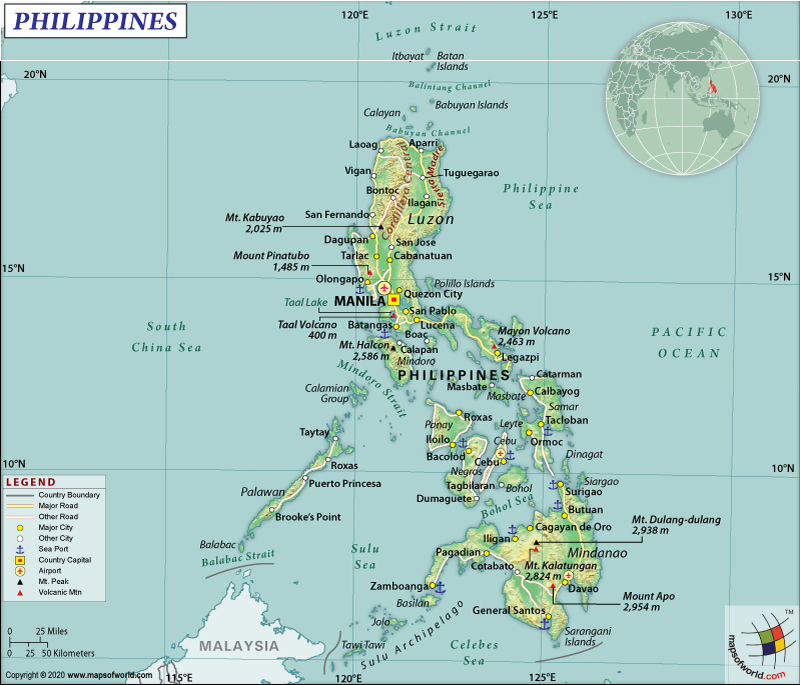

In [15]:
DIFFERENCE_DRAW_FILEPATH = 'difference-drawn.png'

# assign images
img1 = Image.open("original-image.png")
img2 = Image.open("secret-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB')).getbbox()
draw = ImageDraw.Draw(img2)
draw.rectangle(diff)

img2.convert('RGB').save(DIFFERENCE_DRAW_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_DRAW_FILEPATH)
img

These differences can be futher visuallized by mapping the differences into pixels. In this case however, the differences are too little to notice.

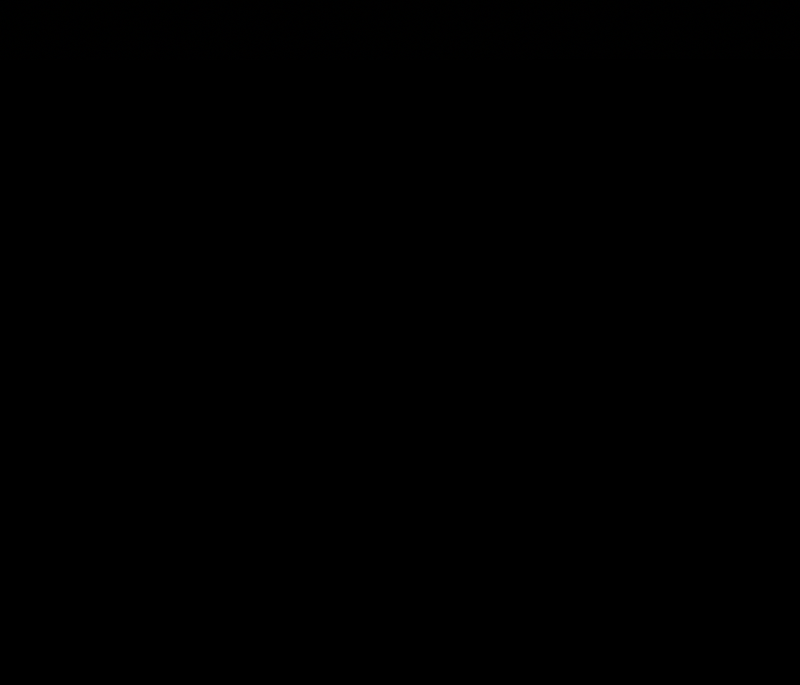

In [16]:
DIFFERENCE_FILEPATH = 'difference.png'

# assign images
img1 = Image.open("original-image.png")
img2 = Image.open("secret-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB'))
diff.save(DIFFERENCE_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_FILEPATH)
img

## Hiding an Image Inside Another Image

Installing the necessary libraries.

In [17]:
%pip install opencv-python
%pip install numpy
%pip install matplotlib
%pip install requests
%pip install scikit-image

Importing the installed libraries.

In [18]:
from PIL import Image
import numpy as np
from io import BytesIO
import requests
from cv2 import imread,imwrite
import matplotlib.pyplot as plt
from skimage import io

A function to convert RGB values (in a `tuple` format of `int` values) to their respective binary representation (in `tuple` format of `string` values).

In [19]:
def int_to_bin(rgb):
  """Convert an integer tuple to a binary (string) tuple.
  :param rgb: An integer tuple (e.g. (220, 110, 96))
  :return: A string tuple (e.g. ("00101010", "11101011", "00010110"))
  """
  r, g, b = rgb
  return (f'{r:08b}',
          f'{g:08b}',
          f'{b:08b}')

A function to binary representation of RGB values (in a `tuple` format of `string` values) to their respective integer values (in `tuple` format of `int` values).

In [20]:
def bin_to_int(rgb):
  """Convert a binary (string) tuple to an integer tuple.
  :param rgb: A string tuple (e.g. ("00101010", "11101011", "00010110"))
  :return: Return an int tuple (e.g. (220, 110, 96))
  """
  r, g, b = rgb
  return (int(r, 2),
          int(g, 2),
          int(b, 2))

A function to merge to two sets of RGB values (in their binary represenation in `string` format, as `tuples`). The first set set will take the 4 MSB while the second 4 LSB upon merging.

In [21]:
def merge_rgb(rgb1, rgb2):
  """Merge two RGB tuples.
  :param rgb1: A string tuple (e.g. ("00101010", "11101011", "00010110"))
  :param rgb2: Another string tuple
  (e.g. ("00101010", "11101011", "00010110"))
  :return: An integer tuple with the two RGB values merged.
  """
  r1, g1, b1 = rgb1
  r2, g2, b2 = rgb2
  rgb = (r1[:4] + r2[:4],
          g1[:4] + g2[:4],
          b1[:4] + b2[:4])
  return rgb

Function to merge a secret image inside a cover image by storing the MSB of the secret image in the LSB of the cover image.

In [22]:
def merge(COVER_IMG_FILEPATH, SECRET_IMG_FILEPATH, OUTPUT_IMG_FILEPATH):
  """Merge two images. The second one will be merged into the first one.
  :param img1: First image
  :param img2: Second image
  :return: A new merged image.
  """
  img1 = Image.open(COVER_IMG_FILEPATH).convert('RGB')
  img2 = Image.open(SECRET_IMG_FILEPATH).convert('RGB')

  # Check the images dimensions.
  if img2.size[0] > img1.size[0] or img2.size[1] > img1.size[1]:
      raise ValueError('Image 2 should not be larger than Image 1!')

  # Get the pixel map of the two images.
  pixel_map1 = img1.load()
  pixel_map2 = img2.load()

  # Create a new image that will be outputted.
  new_image = Image.new(img1.mode, img1.size)
  pixels_new = new_image.load()

  for i in range(img1.size[0]):
      for j in range(img1.size[1]):
          rgb1 = int_to_bin(pixel_map1[i, j])

          # Use a black pixel as default.
          rgb2 = int_to_bin((0, 0, 0))

          # Check if the pixel map position is valid for the second image.
          if i < img2.size[0] and j < img2.size[1]:
              rgb2 = int_to_bin(pixel_map2[i, j])

          # Merge the two pixels and convert it to a integer tuple.
          rgb = merge_rgb(rgb1, rgb2)

          pixels_new[i, j] = bin_to_int(rgb)

  new_image.save(OUTPUT_IMG_FILEPATH)
  
  return new_image

Function to extract the secret image inside a cover image by extracting its LSB and arranging them as the MSB of the secret image.

In [23]:
def unmerge(ENCODED_IMG_FILEPATH, OUTPUT_IMG_FILEPATH):
  """Unmerge an image.
  :param img: The input image.
  :return: The unmerged/extracted image.
  """

  img = Image.open(ENCODED_IMG_FILEPATH)

  # Load the pixel map.
  pixel_map = img.load()

  # Create the new image and load the pixel map.
  new_image = Image.new(img.mode, img.size)
  pixels_new = new_image.load()

  # Tuple used to store the image original size.
  original_size = img.size

  for i in range(img.size[0]):
      for j in range(img.size[1]):
          # Get the RGB (as a string tuple) from the current pixel.
          r, g, b = int_to_bin(pixel_map[i, j])

          # Extract the last 4 bits (corresponding to the hidden image).
          # Concatenate 4 zero bits because we are working with 8 bit.
          rgb = (r[4:] + '0000',
                  g[4:] + '0000',
                  b[4:] + '0000')

          # Convert it to an integer tuple.
          pixels_new[i, j] = bin_to_int(rgb)

          # If this is a 'valid' position, store it.
          # as the last valid position.
          if pixels_new[i, j] != (0, 0, 0):
              original_size = (i + 1, j + 1)

  # Crop the image based on the 'valid' pixels.
  new_image = new_image.crop((0, 0, original_size[0], original_size[1]))

  new_image.save(OUTPUT_IMG_FILEPATH)

  return new_image

### Demonstration

A cover image was set.

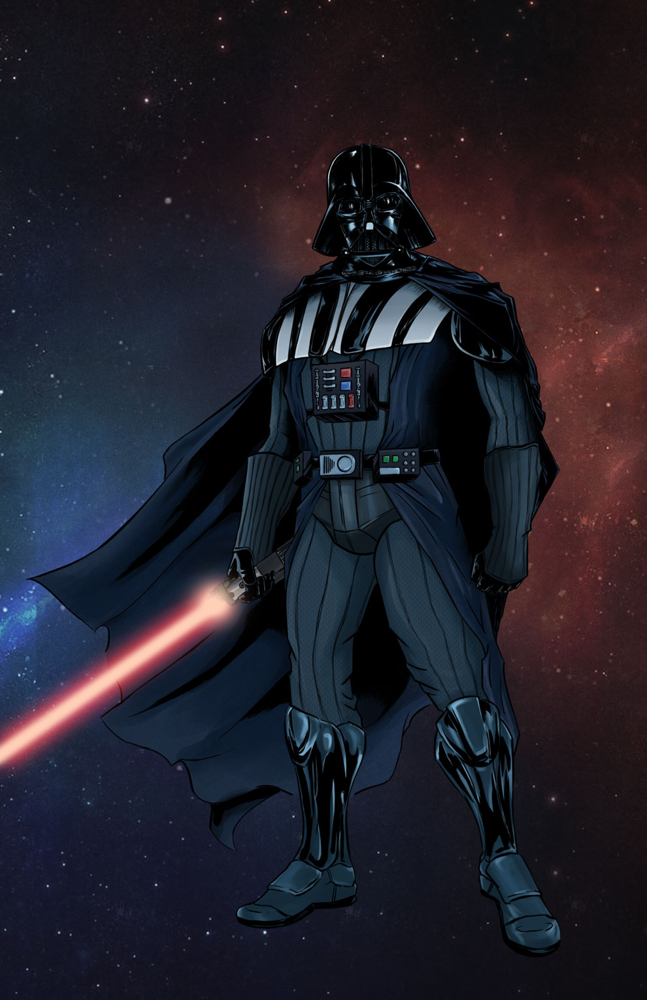

In [24]:
# Cover image
url = 'https://drive.google.com/uc?export=view&id=1y42SI0addSxNfOXqD_RdkNvzcf7o9WtQ'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('cover-image.png')
img

The secret image was set.

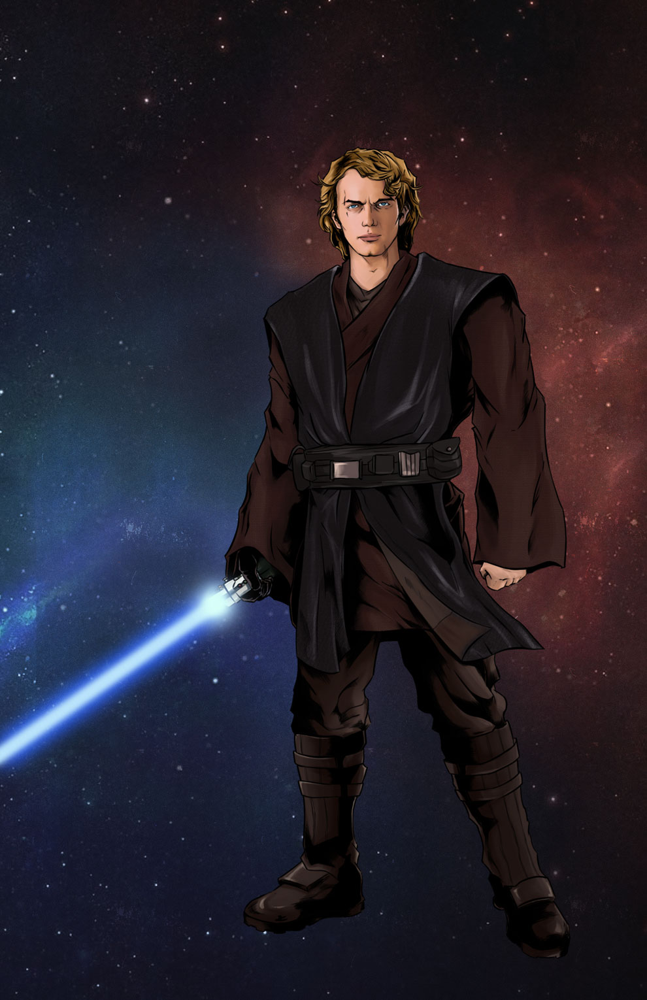

In [25]:
# Secret Image
url = 'https://drive.google.com/uc?export=view&id=1dceae-QYULuxWzDZEfRGk-wvWrLGy_c5'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('secret-image.png')
img

The corresponding file paths were declared and the secret image was hidden inside the cover image.

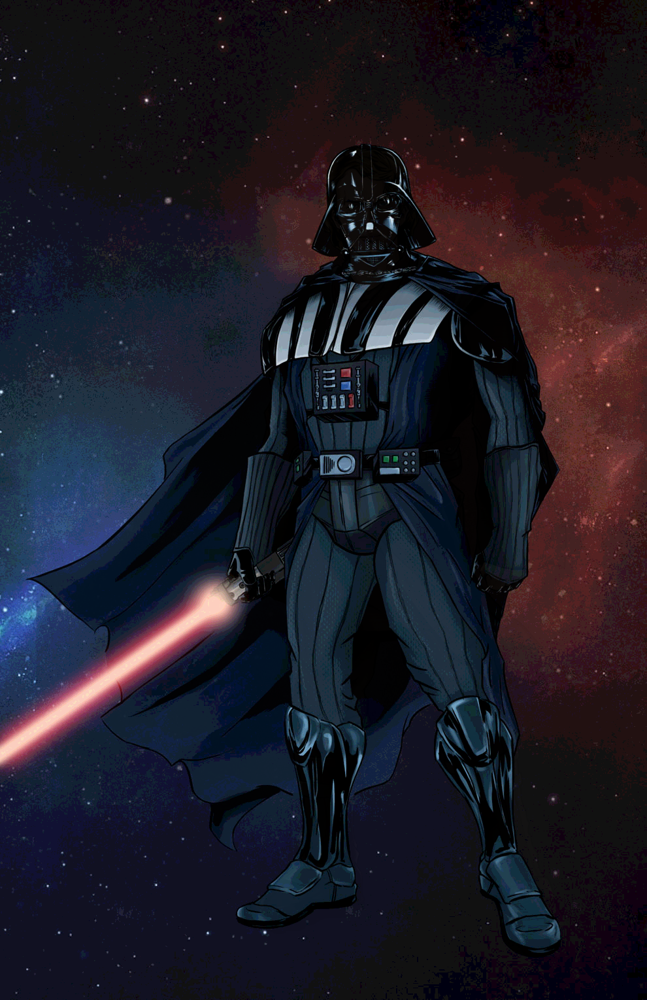

In [26]:
COVER_IMG_FILEPATH = 'cover-image.png'
SECRET_IMG_FILEPATH = 'secret-image.png'
OUTPUT_IMG_FILEPATH = 'encoded-image.png'

merge(COVER_IMG_FILEPATH, SECRET_IMG_FILEPATH, OUTPUT_IMG_FILEPATH)

Side-by-side comparison of the original cover image and the produced stego image using histograms, where in the respective RGB values (from 0-255) for each image are mapped.

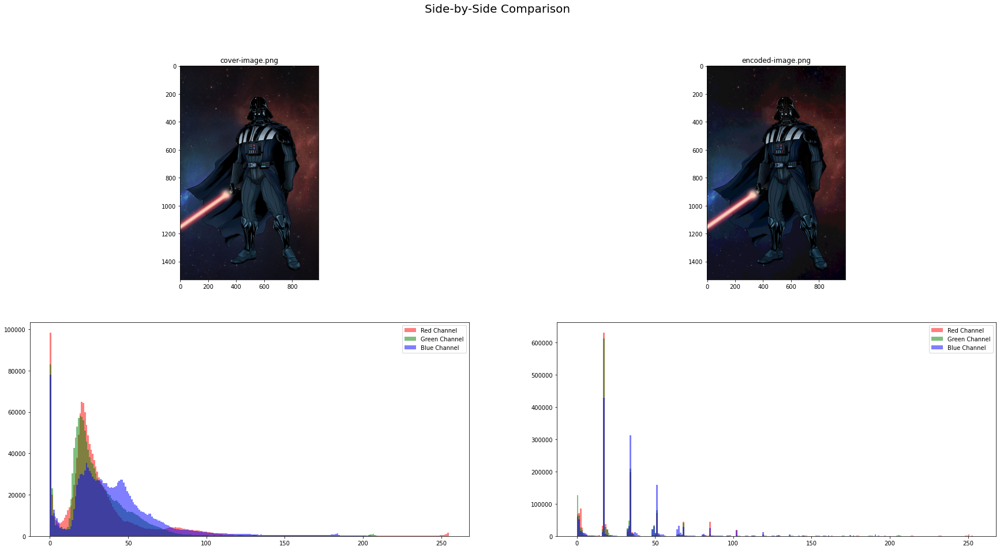

In [27]:
# Original Cover Image and Encoded Image Comparison
COVER_IMAGE = 'cover-image.png'
ENCODED_IMAGE = 'encoded-image.png'

img1 = io.imread(COVER_IMAGE) 
img1_array = np.array(img1, dtype=np.uint8)

img2 = io.imread(ENCODED_IMAGE)
img2_array = np.array(img2, dtype=np.uint8)

NUM_ROWS = 2
IMGs_IN_ROW = 2
f, ax = plt.subplots(NUM_ROWS, IMGs_IN_ROW, figsize=(30,15))
f.suptitle('Side-by-Side Comparison', fontsize=20)

ax[0,0].imshow(img1)
ax[0,0].set_title(COVER_IMAGE)
ax[1,0].hist(img1[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,0].hist(img1[:, :, 1].ravel(), bins = 256, color = 'green', alpha = 0.5)
ax[1,0].hist(img1[:, :, 2].ravel(), bins = 256, color = 'blue', alpha = 0.5)
ax[1,0].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

ax[0,1].imshow(img2)
ax[0,1].set_title(ENCODED_IMAGE)
ax[1,1].hist(img2[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,1].hist(img2[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
ax[1,1].hist(img2[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
ax[1,1].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

plt.show()

The pixel difference across each pair of pixels from the cover image and the encoded image were observed by mapping them in an image of the same dimensions.

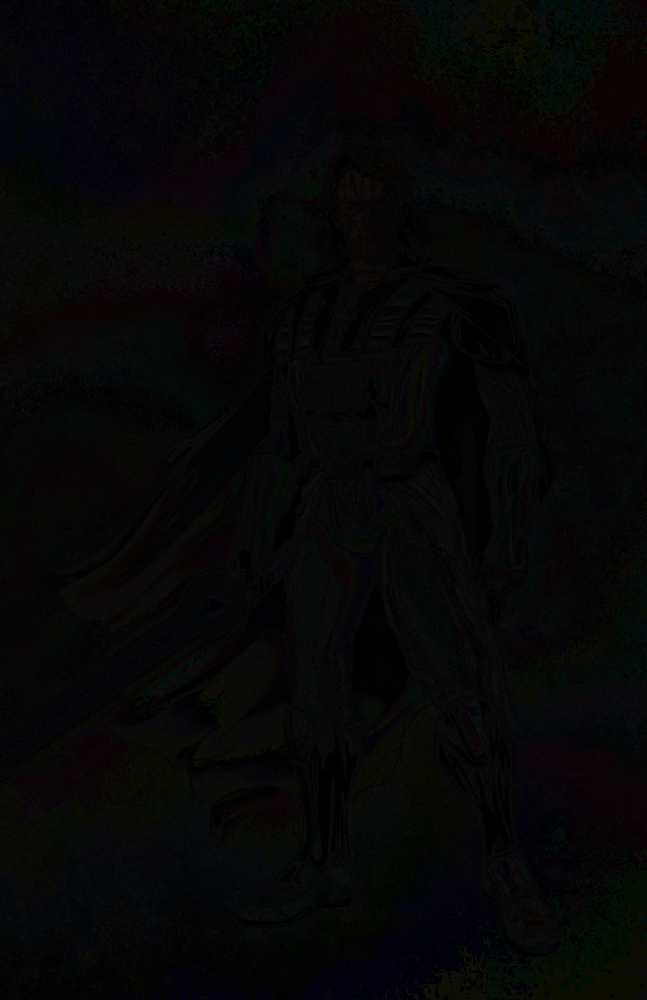

In [28]:
DIFFERENCE_FILEPATH = 'difference.png'

# assign images
img1 = Image.open("cover-image.png")
img2 = Image.open("encoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB'))
diff.save(DIFFERENCE_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_FILEPATH)
img

The secret image inside the stego image was extracted and reconstructed.

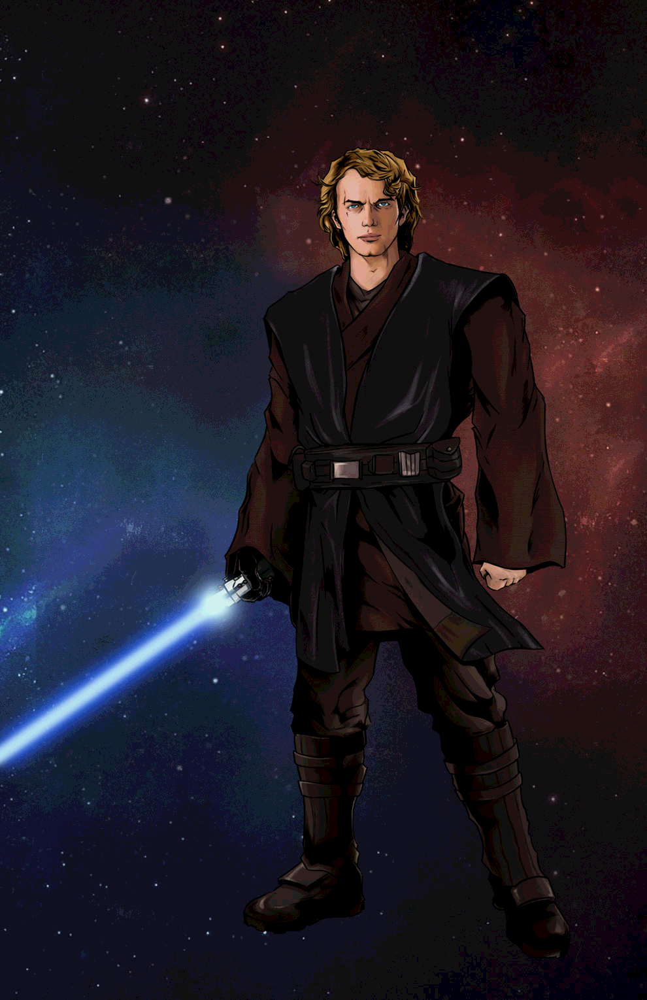

In [29]:
ENCODED_IMG_FILEPATH = 'encoded-image.png'
OUTPUT_IMG_FILEPATH = 'decoded-image.png'

unmerge(ENCODED_IMG_FILEPATH, OUTPUT_IMG_FILEPATH)

Side-by-side comparison of the secret image and its extracted form after reconstrcution using histograms, where in the respective RGB values (from 0-255) for each image are mapped.

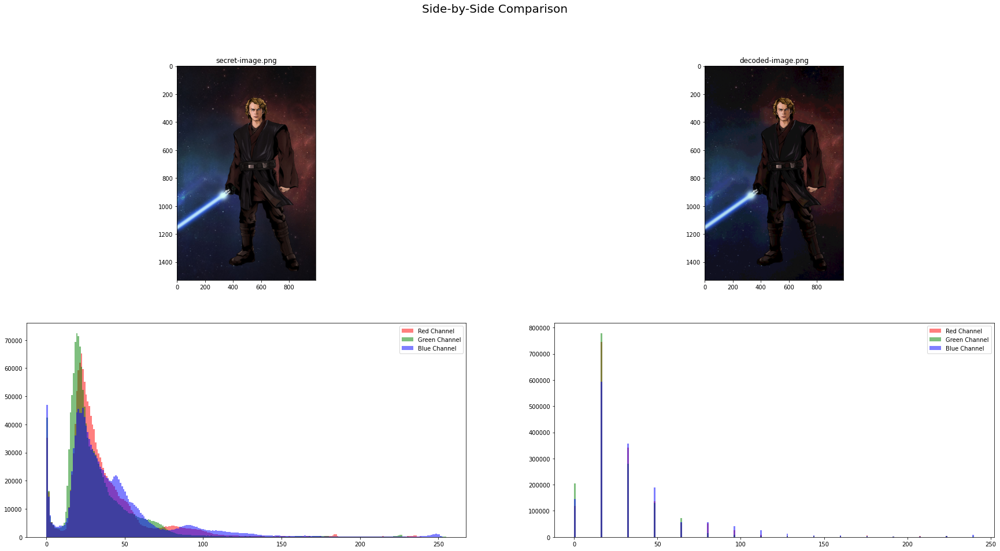

In [30]:
# Original Secret Image and Decoded Image Comparison
SECRET_IMAGE = 'secret-image.png'
DECODED_IMAGE = 'decoded-image.png'

img1 = io.imread(SECRET_IMAGE) 
img1_array = np.array(img1, dtype=np.uint8)

img2 = io.imread(DECODED_IMAGE)
img2_array = np.array(img2, dtype=np.uint8)

NUM_ROWS = 2
IMGs_IN_ROW = 2
f, ax = plt.subplots(NUM_ROWS, IMGs_IN_ROW, figsize=(30,15))
f.suptitle('Side-by-Side Comparison', fontsize=20)

ax[0,0].imshow(img1)
ax[0,0].set_title(SECRET_IMAGE)
ax[1,0].hist(img1[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,0].hist(img1[:, :, 1].ravel(), bins = 256, color = 'green', alpha = 0.5)
ax[1,0].hist(img1[:, :, 2].ravel(), bins = 256, color = 'blue', alpha = 0.5)
ax[1,0].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

ax[0,1].imshow(img2)
ax[0,1].set_title(DECODED_IMAGE)
ax[1,1].hist(img2[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,1].hist(img2[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
ax[1,1].hist(img2[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
ax[1,1].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

plt.show()

The pixel difference across each pair of pixels from the secret image and the decoded image were observed by mapping them in an image of the same dimensions.

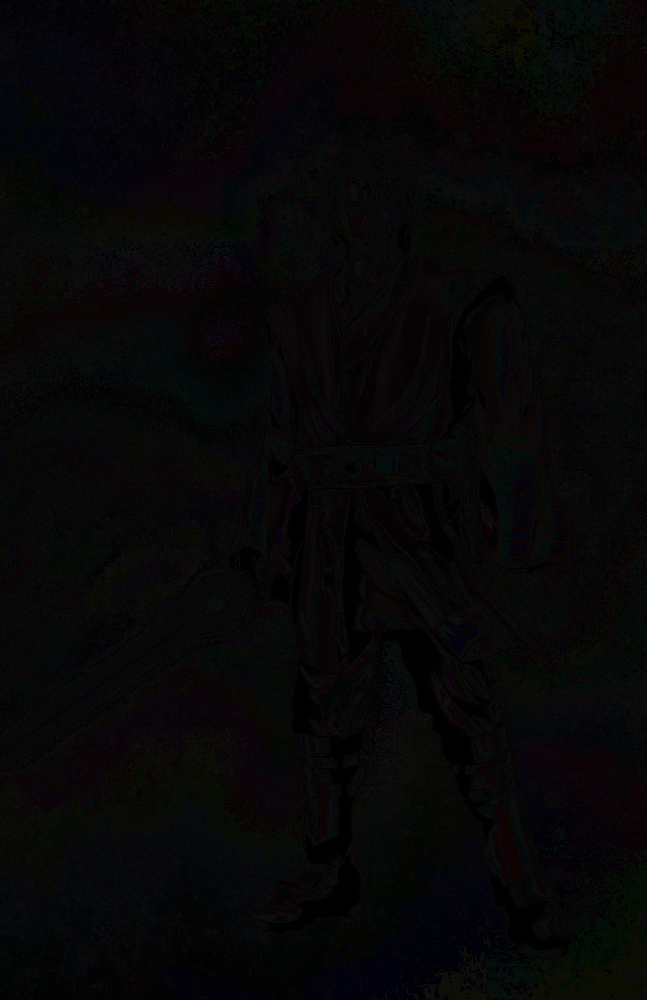

In [31]:
DIFFERENCE_FILEPATH = 'difference.png'

# assign images
img1 = Image.open("secret-image.png")
img2 = Image.open("decoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB'))
diff.save(DIFFERENCE_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_FILEPATH)
img

### Test Case for Actual Application

An example of a [weapon schematic](https://images3.alphacoders.com/211/211797.jpg) embedded in a [military picture](https://english.alaraby.co.uk/sites/default/files/media/images/B3798154-8578-4D42-AC18-62BA3EA61CB6.jpg).

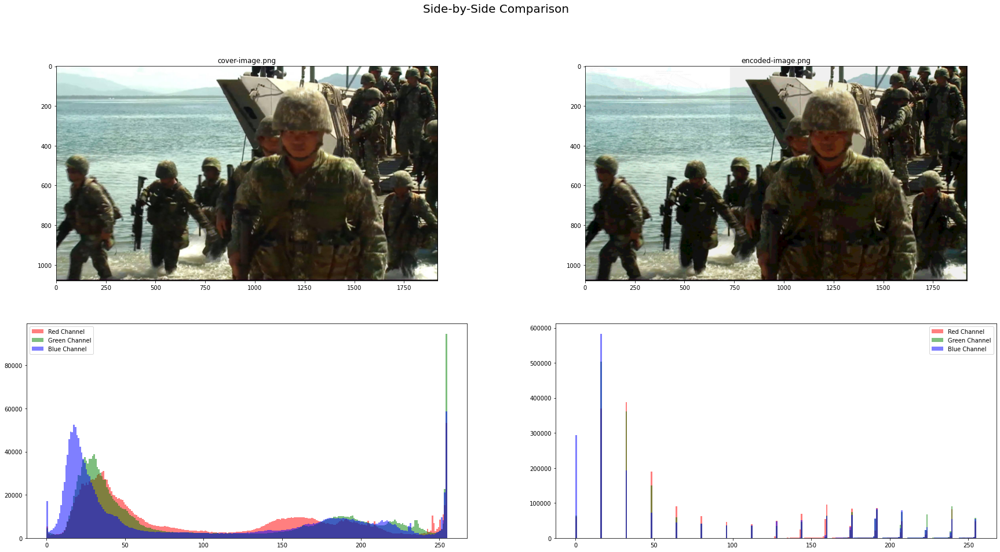

In [32]:
# Cover image
url = 'https://cf-images.eu-west-1.prod.boltdns.net/v1/static/665003303001/3bbb3695-e82c-4f2a-93b9-d9b20d79c39d/68e15a47-ed43-470f-9da7-f03d5a5c64c9/1920x1080/match/image.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('cover-image.png')

# Secret Image
url = 'https://c4.wallpaperflare.com/wallpaper/665/263/635/weapons-schematic-wallpaper-preview.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))
img.save('secret-image.png')

COVER_IMG_FILEPATH = 'cover-image.png'
SECRET_IMG_FILEPATH = 'secret-image.png'
OUTPUT_IMG_FILEPATH = 'encoded-image.png'

merge(COVER_IMG_FILEPATH, SECRET_IMG_FILEPATH, OUTPUT_IMG_FILEPATH)

# Original Cover Image and Encoded Image Comparison
COVER_IMAGE = 'cover-image.png'
ENCODED_IMAGE = 'encoded-image.png'

img1 = io.imread(COVER_IMAGE) 
img1_array = np.array(img1, dtype=np.uint8)

img2 = io.imread(ENCODED_IMAGE)
img2_array = np.array(img2, dtype=np.uint8)

NUM_ROWS = 2
IMGs_IN_ROW = 2
f, ax = plt.subplots(NUM_ROWS, IMGs_IN_ROW, figsize=(30,15))
f.suptitle('Side-by-Side Comparison', fontsize=20)

ax[0,0].imshow(img1)
ax[0,0].set_title(COVER_IMAGE)
ax[1,0].hist(img1[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,0].hist(img1[:, :, 1].ravel(), bins = 256, color = 'green', alpha = 0.5)
ax[1,0].hist(img1[:, :, 2].ravel(), bins = 256, color = 'blue', alpha = 0.5)
ax[1,0].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

ax[0,1].imshow(img2)
ax[0,1].set_title(ENCODED_IMAGE)
ax[1,1].hist(img2[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
ax[1,1].hist(img2[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
ax[1,1].hist(img2[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
ax[1,1].legend(['Red Channel', 'Green Channel', 'Blue Channel'])

plt.show()

The decoded weapon schematic after subjecting the stego image using the inverse of the algorithm.

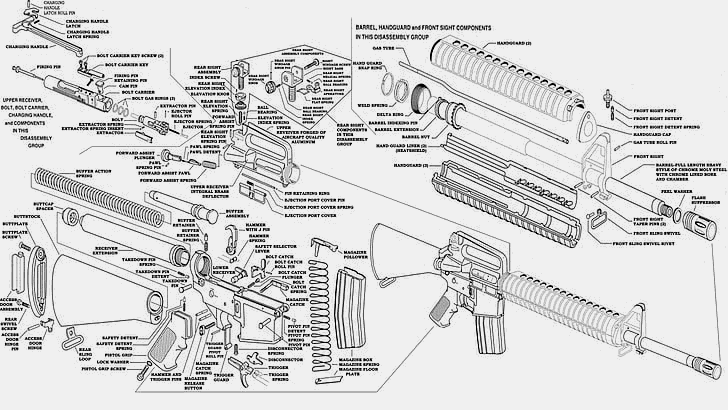

In [33]:
ENCODED_IMG_FILEPATH = 'encoded-image.png'
OUTPUT_IMG_FILEPATH = 'decoded-image.png'

unmerge(ENCODED_IMG_FILEPATH, OUTPUT_IMG_FILEPATH)

The differences among the images were observed calculating the actual difference of the respective original and secret images between the generated encoded image and decoded images pixel by pixel. In this case, the area that was modified that was enclosed in a box was the whole image area since both images share the same pixel dimensions despite having different density.

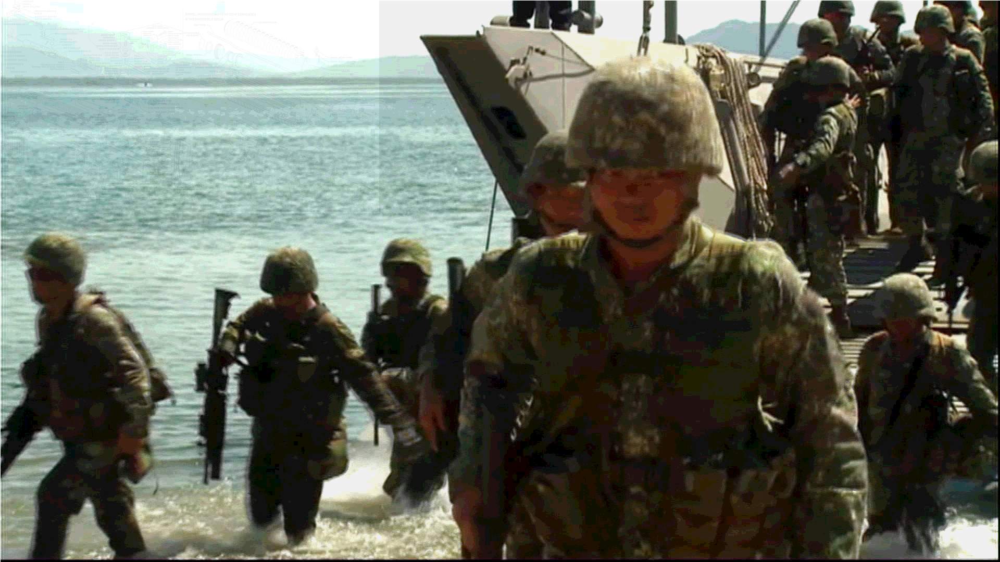

In [34]:
DIFFERENCE_DRAW_FILEPATH = 'difference-drawn-enc-cover.png'

# assign images
img1 = Image.open("cover-image.png")
img2 = Image.open("encoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB')).getbbox()
draw = ImageDraw.Draw(img2)
draw.rectangle(diff)

img2.convert('RGB').save(DIFFERENCE_DRAW_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_DRAW_FILEPATH)
img

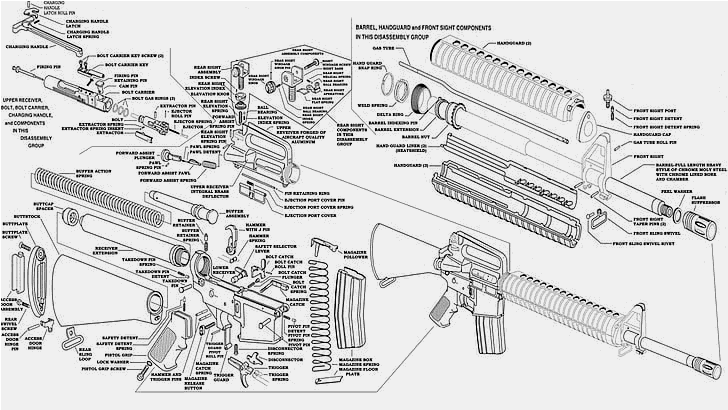

In [35]:
DIFFERENCE_DRAW_FILEPATH = 'difference-drawn-dec-secret.png'

# assign images
img1 = Image.open("secret-image.png")
img2 = Image.open("decoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB')).getbbox()
draw = ImageDraw.Draw(img2)
draw.rectangle(diff)

img2.convert('RGB').save(DIFFERENCE_DRAW_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_DRAW_FILEPATH)
img

To futher visualize how the images differ, the differences among the input and resulting images were mapped in an image with same dimension as the cover image.

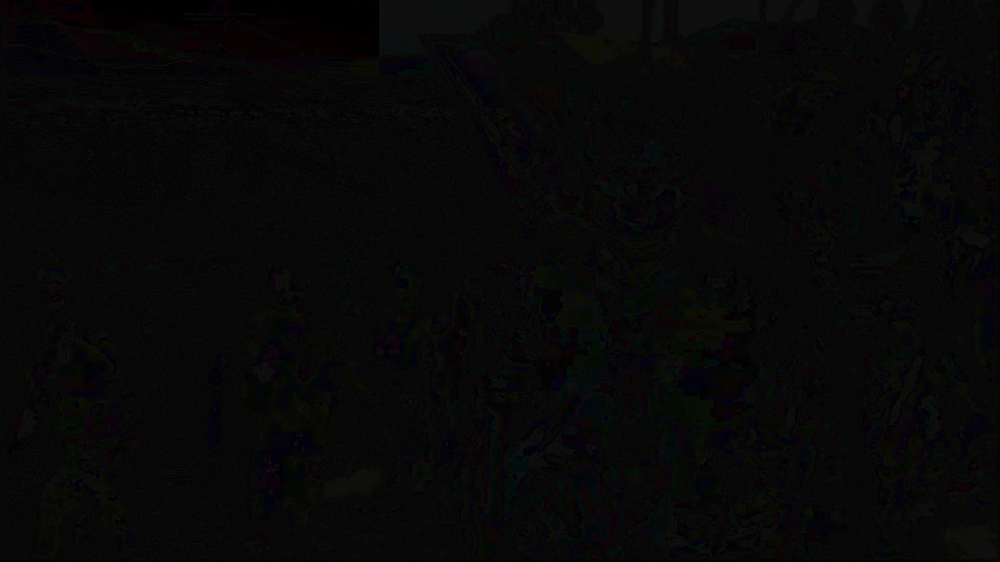

In [36]:
DIFFERENCE_FILEPATH = 'difference-cov-enc.png'

# assign images
img1 = Image.open("cover-image.png")
img2 = Image.open("encoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB'))
diff.save(DIFFERENCE_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_FILEPATH)
img

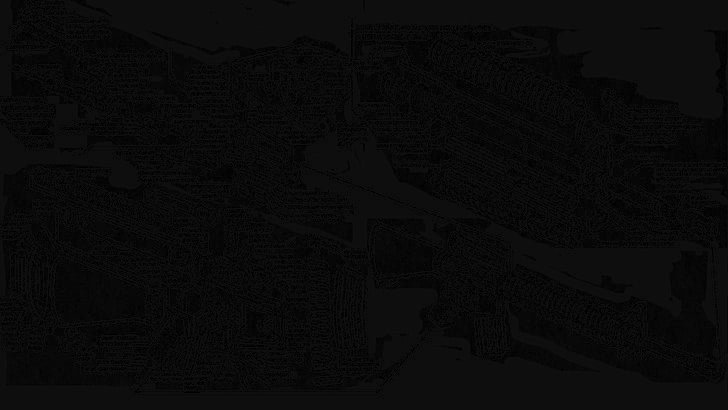

In [37]:
DIFFERENCE_FILEPATH = 'difference-sec-dec.png'

# assign images
img1 = Image.open("secret-image.png")
img2 = Image.open("decoded-image.png")
  
# finding difference
diff = ImageChops.difference(img1.convert('RGB'), img2.convert('RGB'))
diff.save(DIFFERENCE_FILEPATH)
  
# showing the difference
img = Image.open(DIFFERENCE_FILEPATH)
img

## Conclusions
Through image processing, an image can be reduced to its numerical form. In this state, the signals which comprises the image can be manipulated to conceal data, by means wherein the irregularities cannot or at least, cannot be easily seen by the naked eye. This was demonstrated by peforming steganography by hiding *(a) text inside an image* and *(b) image inside another image* by means of manipulating the least signigicant bits (LSB) of an image, either to act as storage for a secret message; or a storage for another image that will undergo reconstruction as the most significant bits for its reconstruction. Ultimately, the application of Digital Signal Processing (DSP) focused on the modification of signals in an image, using mathematical and computational algorithms, in order to produce a new signal, which in this case, provides usefulness in areas of application where covert communication is needed.